## Necessary packages

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import numpy as np
from scipy.stats.mstats import normaltest
from scipy.stats import boxcox 
from sklearn.preprocessing import RobustScaler

## Import data

In [2]:
# Get data directly from local file

data =  pd.read_csv('data/Housing Prices/housing.csv')
data

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


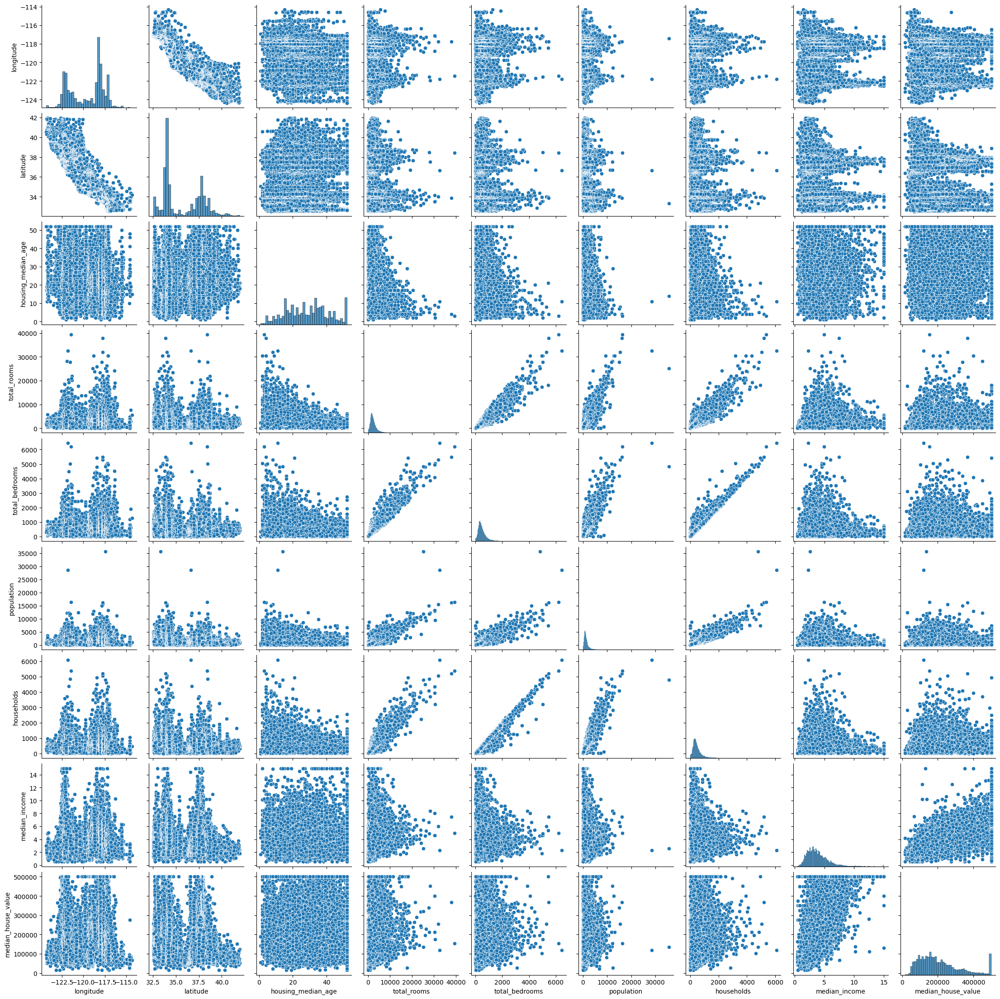

In [4]:
sns.pairplot(data[0:-1])

Transform categorical data to numerical data

In [5]:
one_hot_encode_cols = data.dtypes[data.dtypes == object]  # filtering by string categoricals
one_hot_encode_cols = one_hot_encode_cols.index.tolist()  # list of categorical fields

data[one_hot_encode_cols].head().T

data_ohe = pd.get_dummies(data, columns=one_hot_encode_cols, drop_first=False)
columns = data_ohe.columns
data_ohe

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity_<1H OCEAN,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,False,False,False,True,False
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,False,False,False,True,False
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,False,False,False,True,False
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,False,False,False,True,False
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,False,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,False,True,False,False,False
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,False,True,False,False,False
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,False,True,False,False,False
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,False,True,False,False,False


## Exploring the data

In [6]:
data_ohe = data

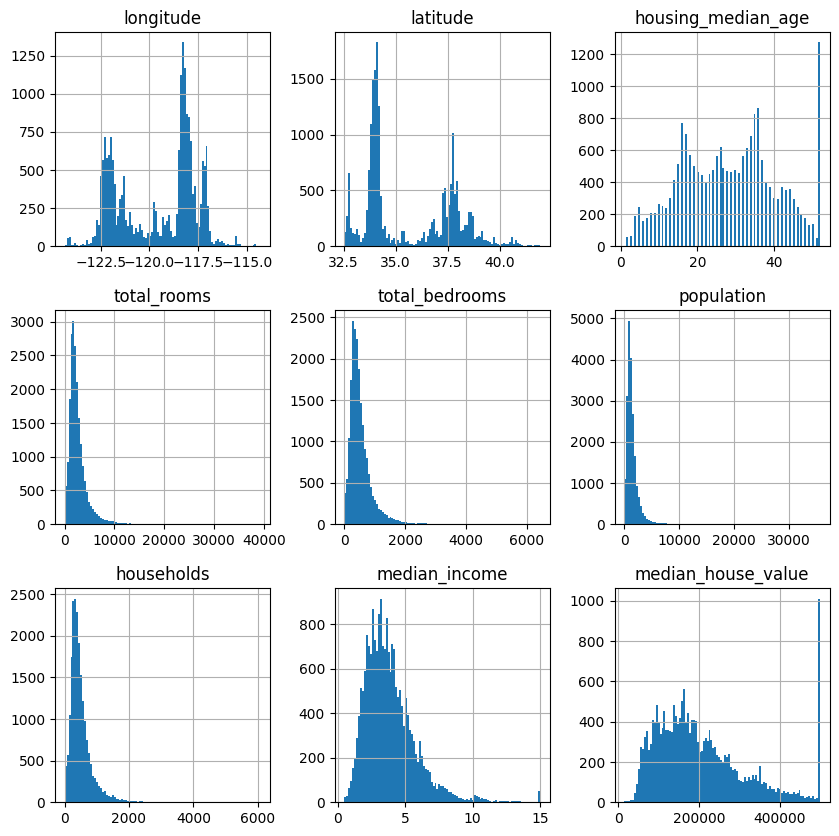

In [7]:
data.hist(bins = 100, figsize = (10, 10))
plt.savefig('Images/Housing Prices Dataset/raw_histogram.png')

## Cleaning the data

Check if there is any nan or null values

In [8]:
nan_values = data_ohe.isna().sum().sum()
null_values = data_ohe.isnull().sum().sum()
print(nan_values)
print(null_values)

207
207


Since the number of nan or null values is low we can remove them from the dataset without affecting it 

In [9]:
data_ohe.dropna(axis = 0, inplace=True)
data_ohe

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


In [10]:
columns = data_ohe.columns

In [11]:
# So we have no non-null items. Lets see if there is any non-sense data 
# (negative or zero values only make sense for longitude and latitude.)

for col in columns[0:-1]:
    num_neg = data_ohe[data_ohe[col] <= 0][col].count()
    print(f"{col}: {num_neg} negative or zero values")

# All the longitude variables are negative, and that makes sense but we cannot transform negative
# values in some cases, so we will traslate the values so the minimum is 1

data_ohe['longitude'] = data_ohe['longitude'] - data_ohe['longitude'].min() + 1

longitude: 20433 negative or zero values
latitude: 0 negative or zero values
housing_median_age: 0 negative or zero values
total_rooms: 0 negative or zero values
total_bedrooms: 0 negative or zero values
population: 0 negative or zero values
households: 0 negative or zero values
median_income: 0 negative or zero values
median_house_value: 0 negative or zero values


## Remove Skewness

For our data without any transformation, we can look if some is normally distributed

In [12]:
normaltest(data_ohe[columns[0:-5]]).pvalue

array([0., 0., 0., 0., 0.])

Lets transform and visualize our data with diferent transformation functions

0.0
0.0
4.71068179284958e-267
7.772730337217876e-248
3.659457117371275e-215
2.3007330022917982e-219
5.898249280240371e-212
7.743210544285517e-17
1.3074094153405415e-96


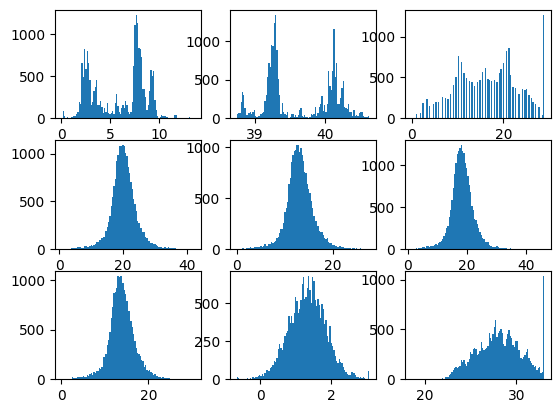

In [13]:
# Boxcox transformation

fig, ax = plt.subplots(3, 3)

for ii in range(3):
    for jj in range(3):

        transf = boxcox(data_ohe[columns[3*ii + jj]])[0]
        print(normaltest(transf).pvalue)

        col = 3*ii + jj
        ax[ii, jj].hist(transf, bins = 100)

0.0
0.0
0.0
0.0
0.0
0.0
0.0
6.02639625930544e-37
9.128234347651967e-78


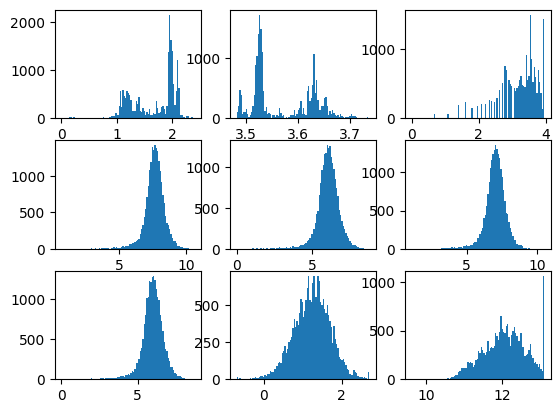

In [14]:
# Log transformation
fig, ax = plt.subplots(3, 3)

for ii in range(3):
    for jj in range(3):
        try:
            transf = np.log(data_ohe[columns[3*ii + jj]])
            print(normaltest(transf).pvalue)
        except:
            transf = 0
        col = 3*ii + jj
        ax[ii, jj].hist(transf, bins = 100)

0.0
0.0
1.0578730157597332e-170
0.0
0.0
0.0
0.0
0.0
3.591710502119472e-184


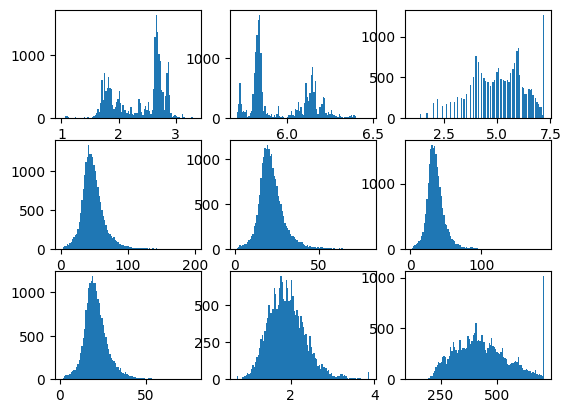

In [15]:
# sqrt transformation
fig, ax = plt.subplots(3, 3)

for ii in range(3):
    for jj in range(3):
        try:
            transf = np.sqrt(data_ohe[columns[3*ii + jj]])
            print(normaltest(transf).pvalue)
        except:
            transf = 0
        col = 3*ii + jj
        ax[ii, jj].hist(transf, bins = 100)

After exploring the transformations I decided to do the following before searching for outliers

array([[<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'housing_median_age'}>],
       [<Axes: title={'center': 'total_rooms'}>,
        <Axes: title={'center': 'total_bedrooms'}>,
        <Axes: title={'center': 'population'}>],
       [<Axes: title={'center': 'households'}>,
        <Axes: title={'center': 'median_income'}>,
        <Axes: title={'center': 'median_house_value'}>]], dtype=object)

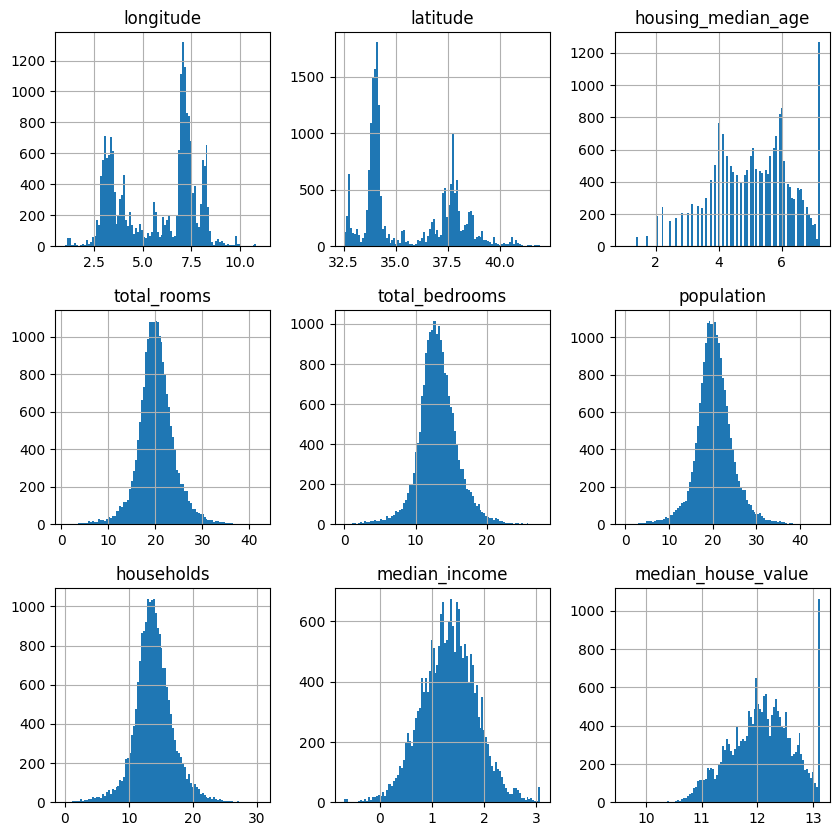

In [16]:
data_ohe[columns[2]] = np.sqrt(data_ohe[columns[2]])
data_ohe[columns[3]] = boxcox(data_ohe[columns[3]])[0]
data_ohe[columns[4]] = boxcox(data_ohe[columns[4]])[0]
data_ohe[columns[5]] = boxcox(data_ohe[columns[3]])[0]
data_ohe[columns[6]] = boxcox(data_ohe[columns[6]])[0]
data_ohe[columns[7]] = boxcox(data_ohe[columns[7]])[0]
data_ohe[columns[8]] = np.log(data_ohe[columns[8]])

data_ohe.hist(bins = 100, figsize= (10, 10))

In [17]:
data_ohe

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,3.12,37.88,6.403124,15.711183,8.812635,15.510641,9.276867,2.339704,13.022764,NEAR BAY
1,3.13,37.86,4.582576,27.567255,17.043806,28.395290,18.837657,2.336226,12.789684,NEAR BAY
2,3.11,37.85,7.211103,18.129399,10.018273,18.121968,10.438155,2.173976,12.771671,NEAR BAY
3,3.10,37.85,7.211103,17.434442,10.726091,17.370485,11.216602,1.875594,12.740517,NEAR BAY
4,3.10,37.85,7.211103,18.653359,11.335470,18.689065,11.859220,1.434004,12.743151,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,4.26,39.48,5.000000,18.771858,12.396339,18.817381,12.835209,0.454096,11.265745,INLAND
20636,4.14,39.49,4.242641,14.695478,9.269814,14.416990,8.952949,0.980434,11.252859,INLAND
20637,4.13,39.43,4.123106,20.383726,13.409430,20.564906,14.000827,0.543777,11.432799,INLAND
20638,4.03,39.43,4.242641,19.348787,12.738405,19.442413,13.069100,0.642702,11.346871,INLAND


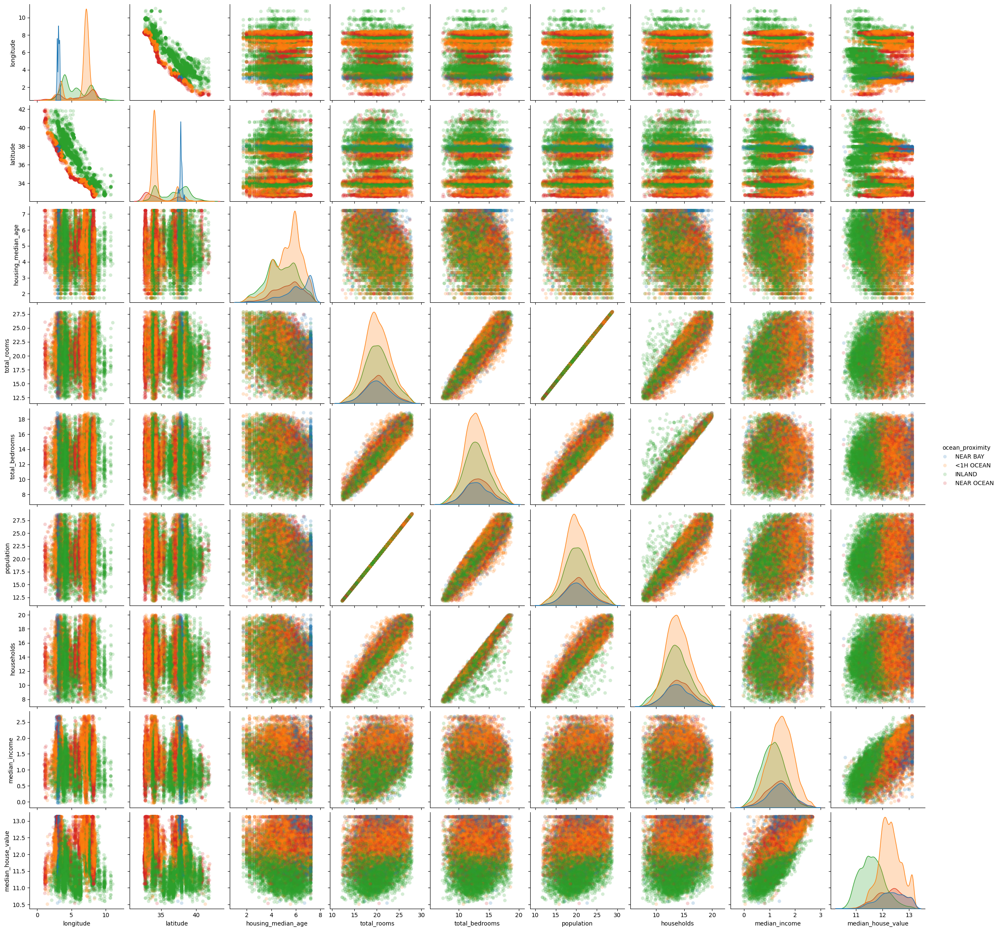

In [18]:
for col in columns[0:-1]:
    Q1 = data_ohe[col].quantile(0.25)
    Q3 = data_ohe[col].quantile(0.75)
    IQR = Q3 - Q1    #IQR is interquartile range. 

    filter = (data_ohe[col] >= Q1 - 1.5 * IQR) & (data_ohe[col] <= Q3 + 1.5 *IQR)
    data_ohe = data_ohe.loc[filter]  

data_ohe = data_ohe[data_ohe['ocean_proximity'] != 'ISLAND']
sns.pairplot(data_ohe, plot_kws = dict(alpha = 0.2, edgecolor = 'none'), hue = 'ocean_proximity')

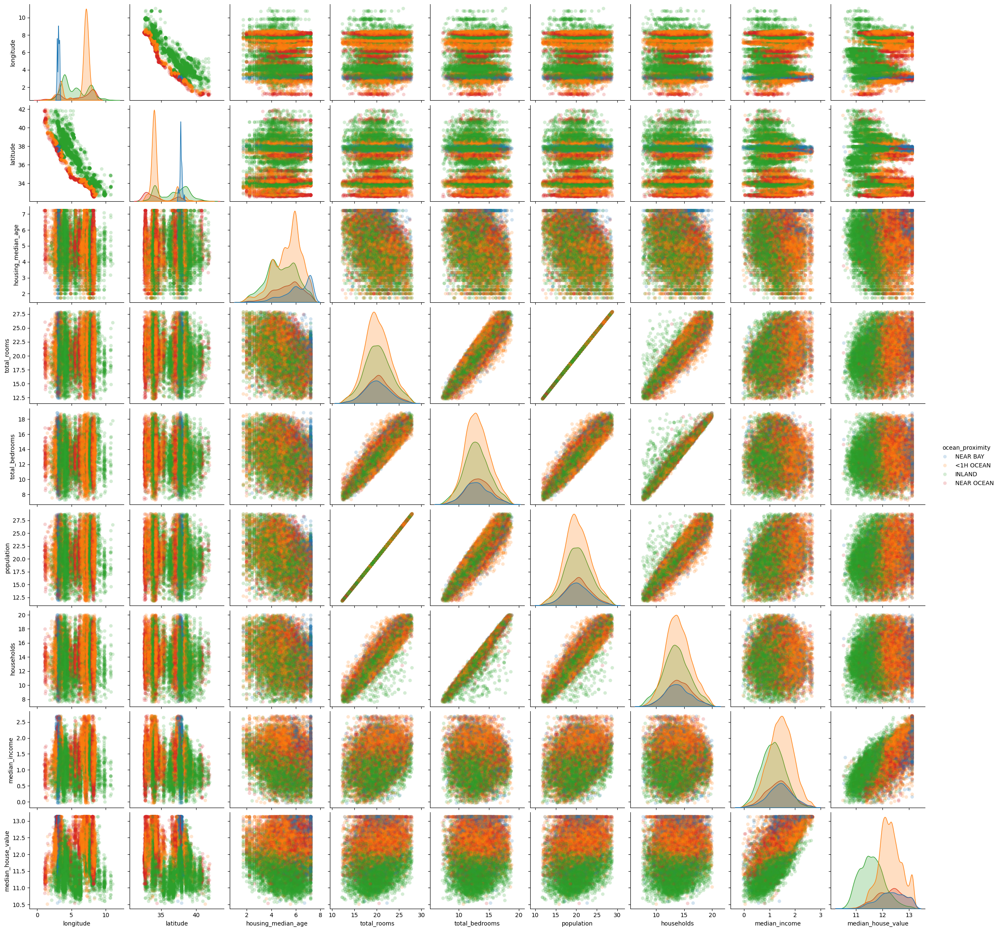

In [19]:
sns.pairplot(data_ohe, plot_kws = dict(alpha = 0.2, edgecolor = 'none'), hue = 'ocean_proximity')
plt.savefig('Images/Housing Prices Dataset/pair_plot.png')

In [20]:
np.corrcoef(data_ohe['median_income'], data_ohe['median_house_value'])[0, 1]

0.6890137924255043

Remove outliers with robust scaler

array([[<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'housing_median_age'}>],
       [<Axes: title={'center': 'total_rooms'}>,
        <Axes: title={'center': 'total_bedrooms'}>,
        <Axes: title={'center': 'population'}>],
       [<Axes: title={'center': 'households'}>,
        <Axes: title={'center': 'median_income'}>,
        <Axes: title={'center': 'median_house_value'}>]], dtype=object)

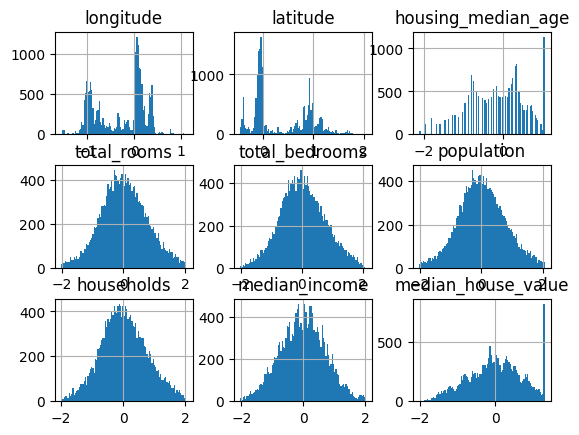

In [21]:
rob_scale = RobustScaler()
rob_data_ohe = rob_scale.fit_transform(data_ohe[columns[0:-1]])
rob_data_ohe = pd.DataFrame(rob_data_ohe, columns=columns[0:-1])
rob_data_ohe.hist(bins = 100)

## Visualize relationships between feature-feature and feature-target

In [22]:
data_ohe = data_ohe[data_ohe['ocean_proximity'] != 'ISLAND']

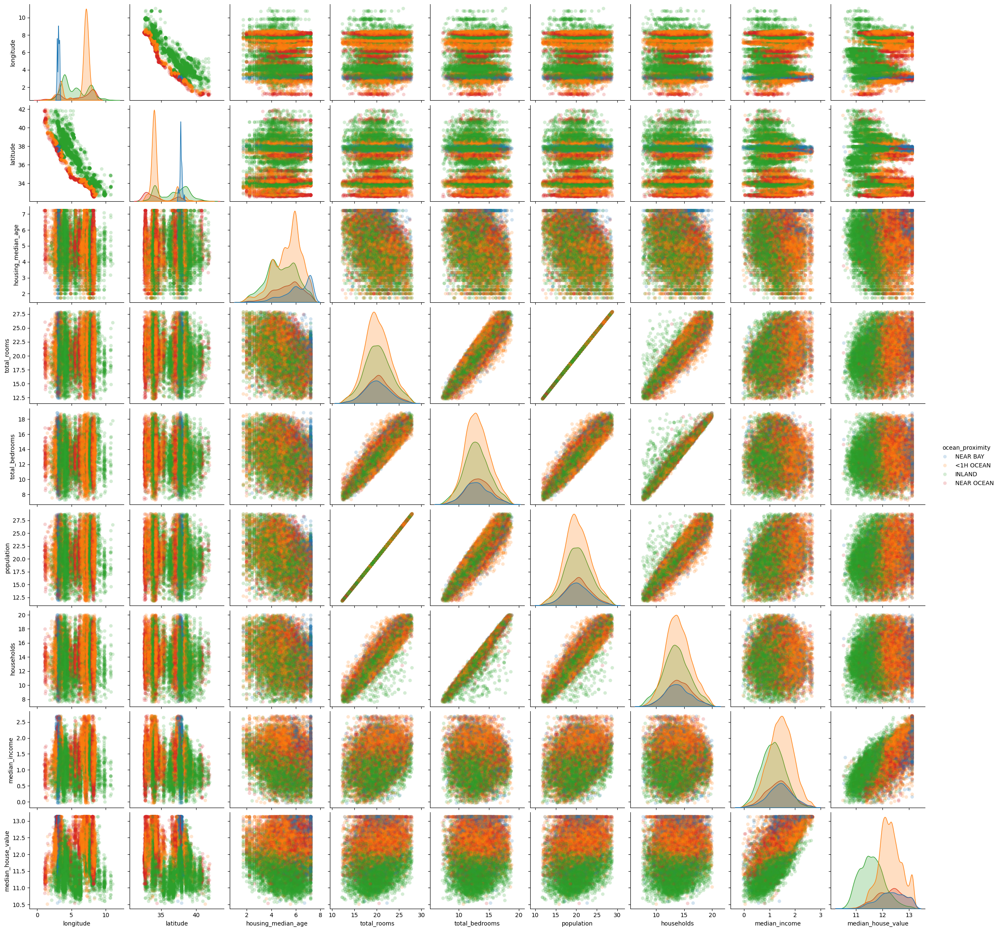

In [23]:
sns.pairplot(data_ohe, plot_kws = dict(alpha = 0.2, edgecolor = 'none'), hue = 'ocean_proximity')
plt.savefig('pair_plot.png')

In [24]:
np.corrcoef(data_ohe['median_income'], data_ohe['median_house_value'])[0, 1]

0.6890137924255043

We cannot see a great relation between features and target, this might be influenced by the categorical data. We can split this data to see if there is any relation for each category. 

In [25]:
hour_ocean_data = data[data['ocean_proximity_<1H OCEAN'] == 1]
inland_data = data[data['ocean_proximity_INLAND'] == 1]
island_data = data[data['ocean_proximity_ISLAND'] == 1]
near_bay_data = data[data['ocean_proximity_NEAR BAY'] == 1]
near_ocean_data = data[data['ocean_proximity_NEAR OCEAN'] == 1]

KeyError: 'ocean_proximity_<1H OCEAN'

Lets do the pair plot again for each of this categories

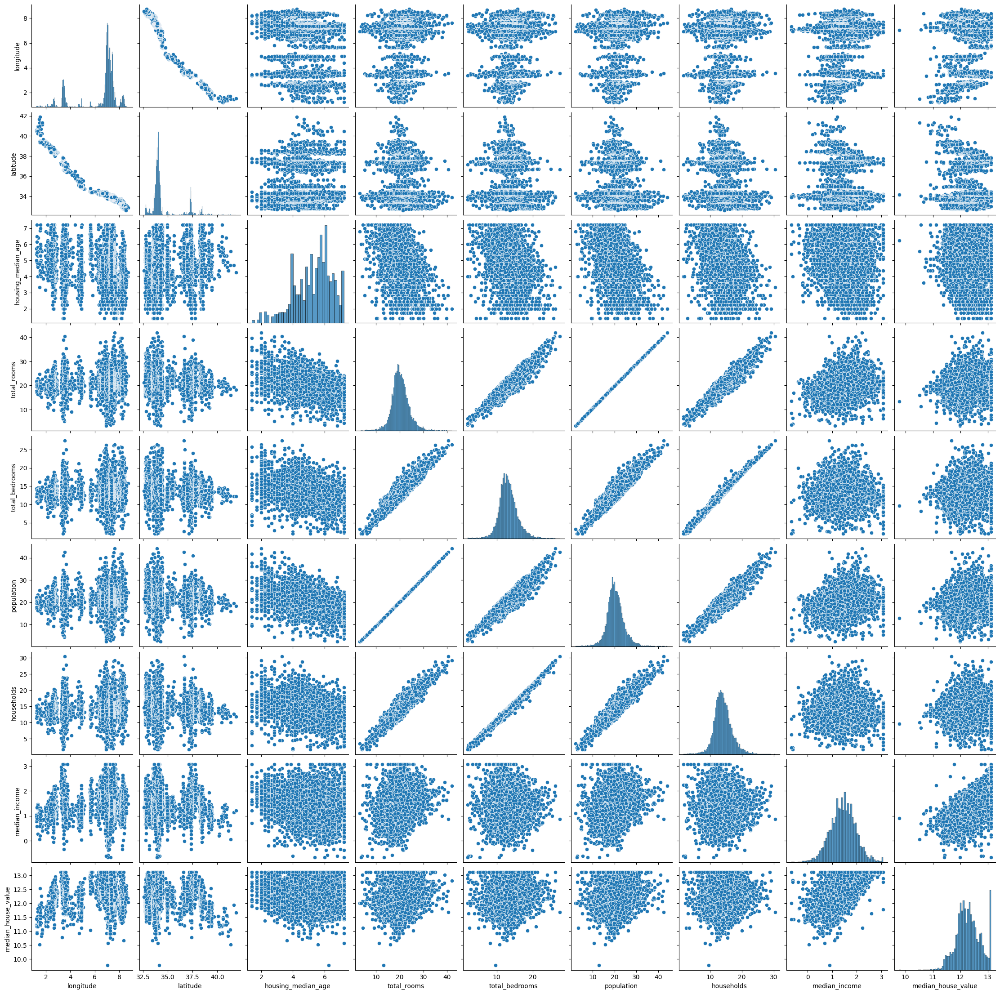

In [ ]:
sns.pairplot(hour_ocean_data[columns[0:-5]])

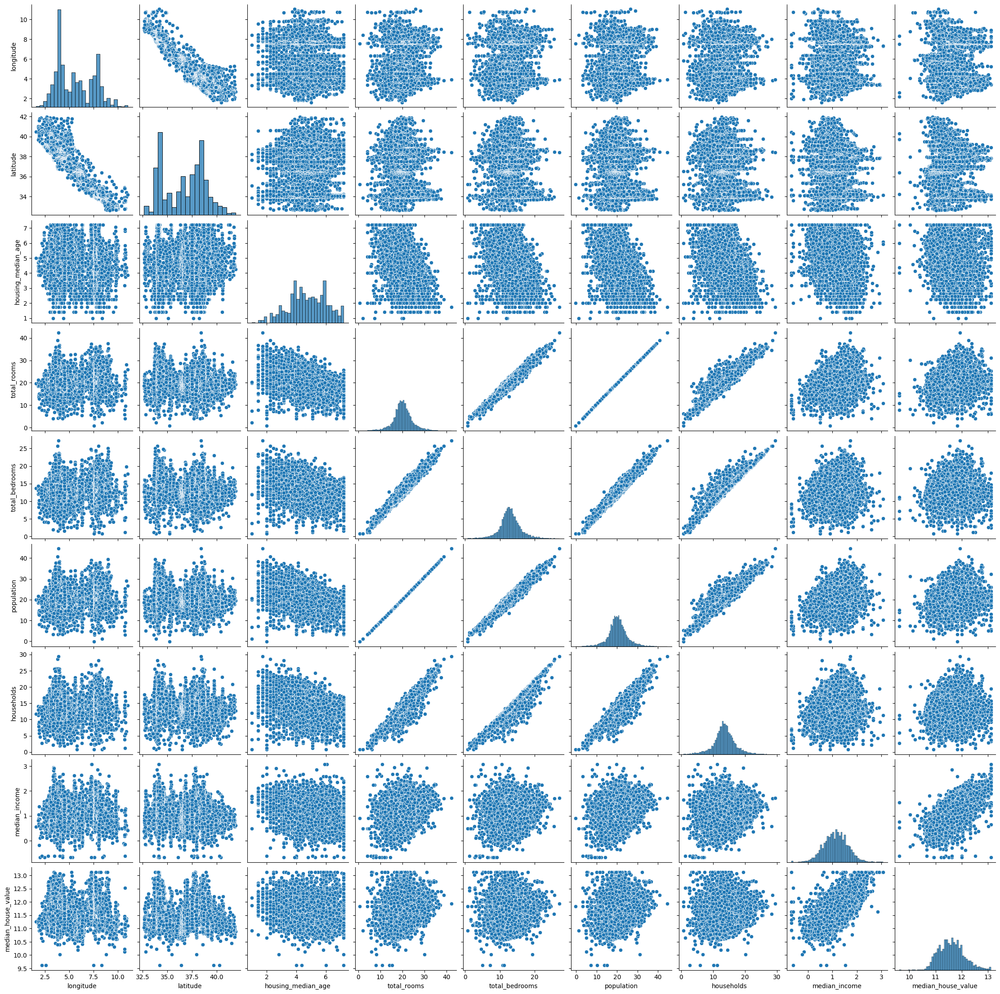

In [ ]:
sns.pairplot(inland_data[columns[0:-5]])

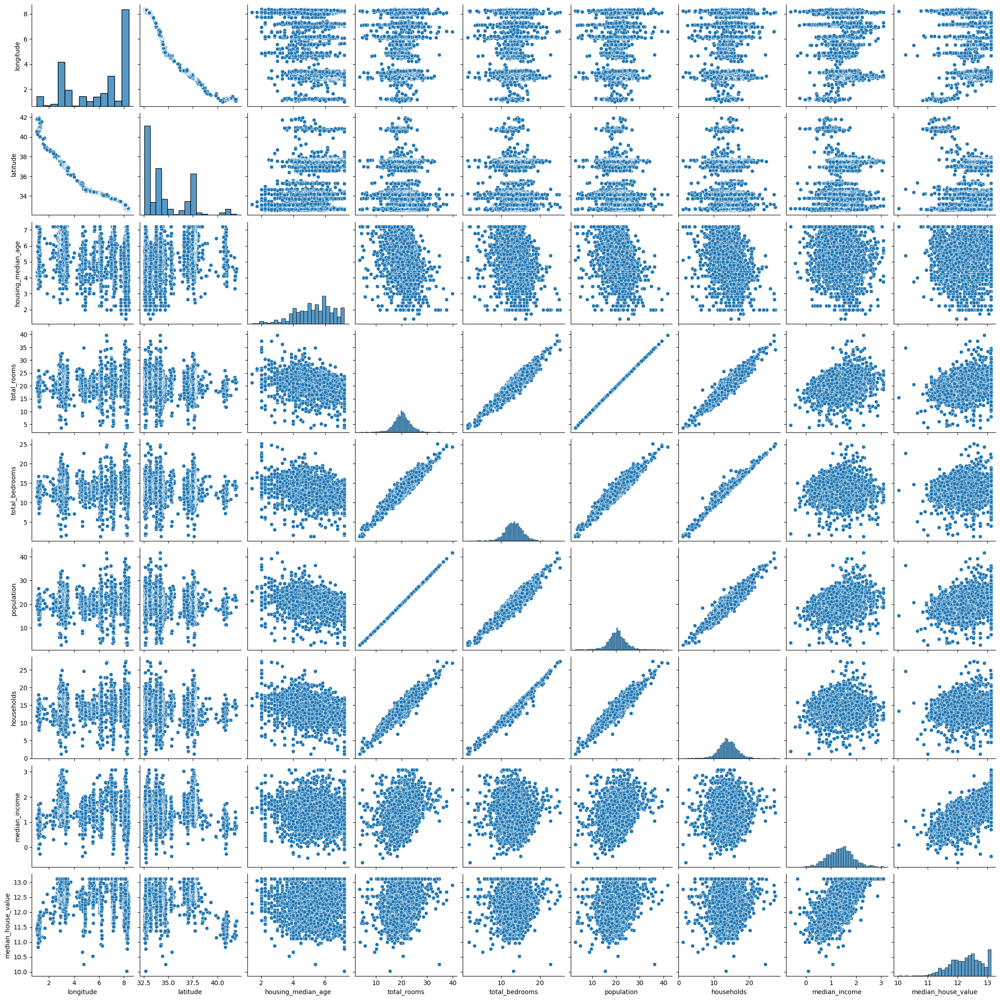

In [ ]:
sns.pairplot(near_ocean_data[columns[0:-5]])

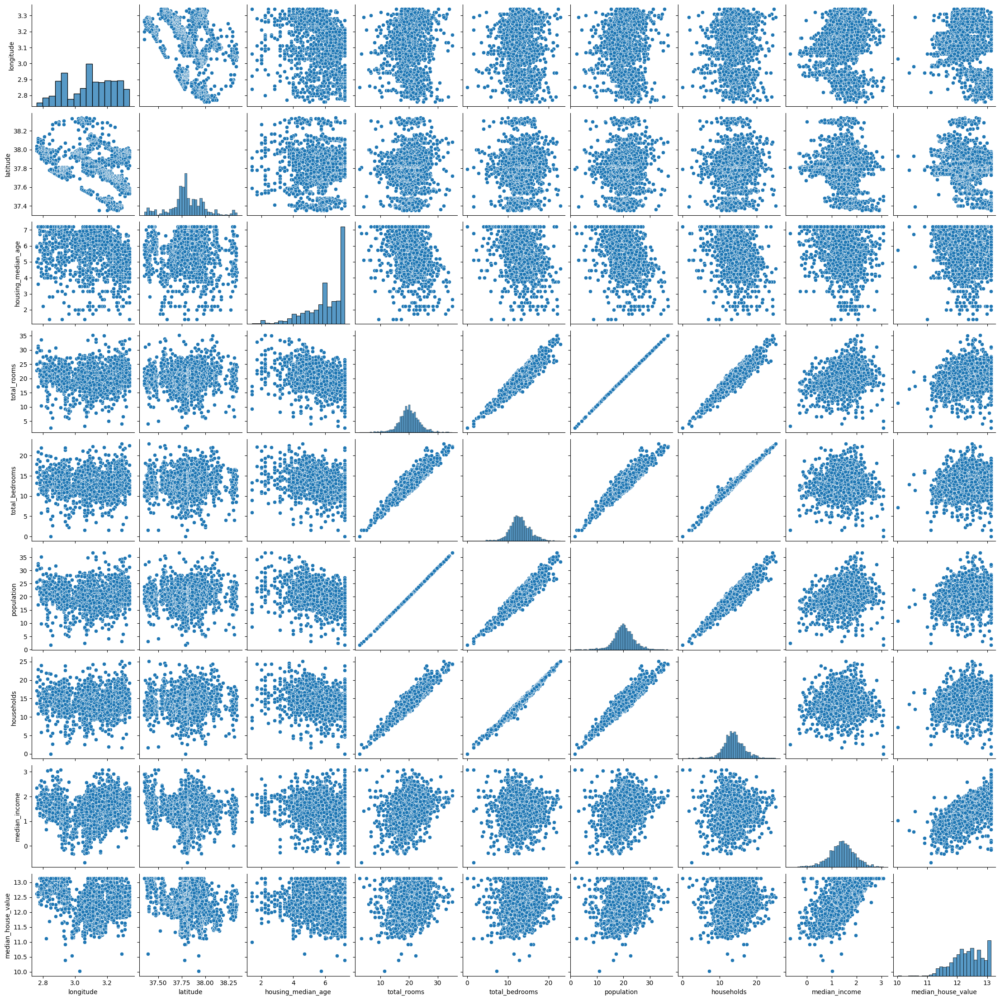

In [ ]:
sns.pairplot(near_bay_data[columns[0:-5]])

In [ ]:
for col in columns[0:-1]:
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)
    IQR = Q3 - Q1    #IQR is interquartile range. 

    filter = (data[col] >= Q1 - 1.5 * IQR) & (data[col] <= Q3 + 1.5 *IQR)
    data = data.loc[filter]  

data = data[data['ocean_proximity'] != 'ISLAND']

array([[<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'housing_median_age'}>],
       [<Axes: title={'center': 'total_rooms'}>,
        <Axes: title={'center': 'total_bedrooms'}>,
        <Axes: title={'center': 'population'}>],
       [<Axes: title={'center': 'households'}>,
        <Axes: title={'center': 'median_income'}>,
        <Axes: title={'center': 'median_house_value'}>]], dtype=object)

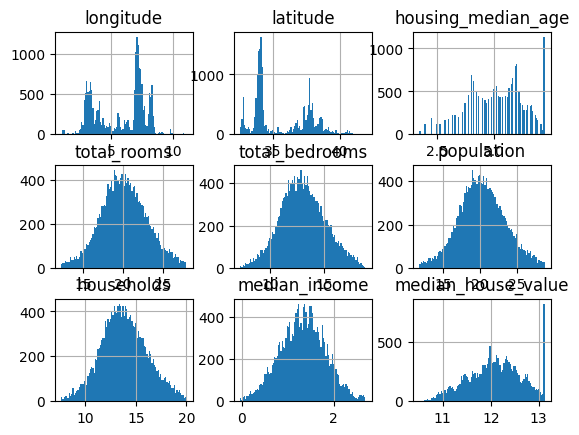

In [ ]:
data.hist(bins = 100)

In [ ]:
data.dropna(axis = 0, inplace=True)
data

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


array([[<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'housing_median_age'}>],
       [<Axes: title={'center': 'total_rooms'}>,
        <Axes: title={'center': 'total_bedrooms'}>,
        <Axes: title={'center': 'population'}>],
       [<Axes: title={'center': 'households'}>,
        <Axes: title={'center': 'median_income'}>,
        <Axes: title={'center': 'median_house_value'}>]], dtype=object)

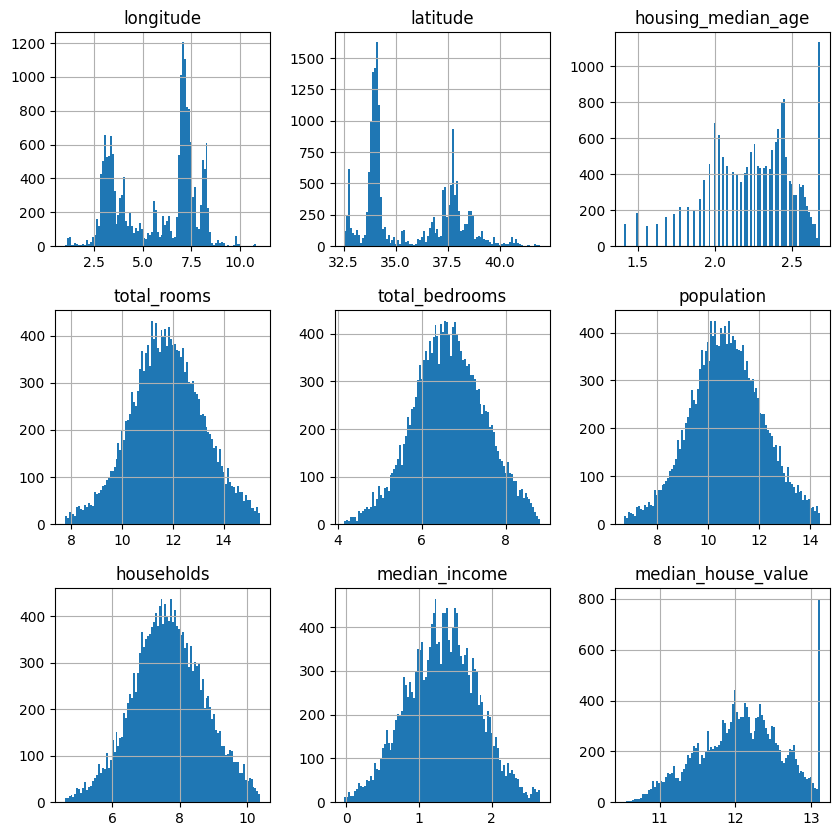

In [ ]:
data[columns[2]] = np.sqrt(data[columns[2]])
data[columns[3]] = boxcox(data[columns[3]])[0]
data[columns[4]] = boxcox(data[columns[4]])[0]
data[columns[5]] = boxcox(data[columns[3]])[0]
data[columns[6]] = boxcox(data[columns[6]])[0]
data[columns[7]] = boxcox(data[columns[7]])[0]
data[columns[8]] = np.log(data[columns[8]])

data.hist(bins = 100, figsize= (10, 10))

In [ ]:
normaltest(data)

NameError: name 'normaltest' is not defined